In [65]:
#!/usr/bin/python2.6  
# -*- coding: utf-8 -*-  
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
import cv2
import math

plt.rcParams['font.sans-serif']=['SimHei'] #显示中文标签


from tensorflow import keras
from tensorflow.keras.preprocessing import image
from tensorflow.keras import models, optimizers, regularizers
print(tf.__version__)

2.1.0


In [3]:
height = 224
width = 224
channels = 3
batch_size = 64
num_classes = 20
weight_decay = 5e-4

In [29]:
VGG16_MODEL = tf.keras.applications.VGG16(include_top=False, weights='imagenet')

In [40]:
layer_outputs = [layer.output for layer in VGG16_MODEL.layers[2:20]]

In [43]:
# 获取各层的名称：
layer_names = []
for layer in VGG16_MODEL.layers[2:20]:
    layer_names.append(layer.name)
print(layer_names)

['block1_conv2', 'block1_pool', 'block2_conv1', 'block2_conv2', 'block2_pool', 'block3_conv1', 'block3_conv2', 'block3_conv3', 'block3_pool', 'block4_conv1', 'block4_conv2', 'block4_conv3', 'block4_pool', 'block5_conv1', 'block5_conv2', 'block5_conv3', 'block5_pool']


In [44]:
model = keras.models.Model(inputs=VGG16_MODEL.input, outputs=layer_outputs)

In [45]:
model.summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, None, None, 3)]   0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, None, None, 64)    1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, None, None, 64)    36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, None, None, 64)    0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, None, None, 128)   73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, None, None, 128)   147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, None, None, 128)   0   

In [67]:
monkey_image = cv2.imread("d:/note/monkey.jpg")
# monkey_image = cv2.resize(monkey_image,(224,224))

In [68]:
monkey_image= np.expand_dims(monkey_image,0)

In [69]:
activations = model.predict(monkey_image)

In [70]:
activations[0][0,:,:,0]

array([[300.5632  , 109.0386  , 114.46074 , ..., 130.2692  ,  23.791023,
          0.      ],
       [111.96598 ,   0.      ,   0.      , ...,   0.      ,   0.      ,
          0.      ],
       [ 98.90308 ,   0.      ,  43.84136 , ...,  47.69515 ,   0.      ,
          0.      ],
       ...,
       [731.17865 ,   0.      , 182.64972 , ..., 274.90176 ,   0.      ,
          0.      ],
       [356.3196  ,   0.      ,   0.      , ...,   0.      ,   0.      ,
          0.      ],
       [  0.      ,   0.      ,   0.      , ...,   0.      ,   0.      ,
        486.6134  ]], dtype=float32)

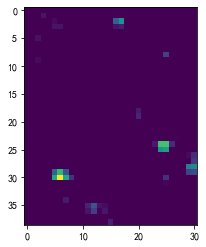

In [91]:
plt.imshow(activations[16][0,:,:,0])

In [85]:
activations[12][0,:,:,0].shape

(79, 62)

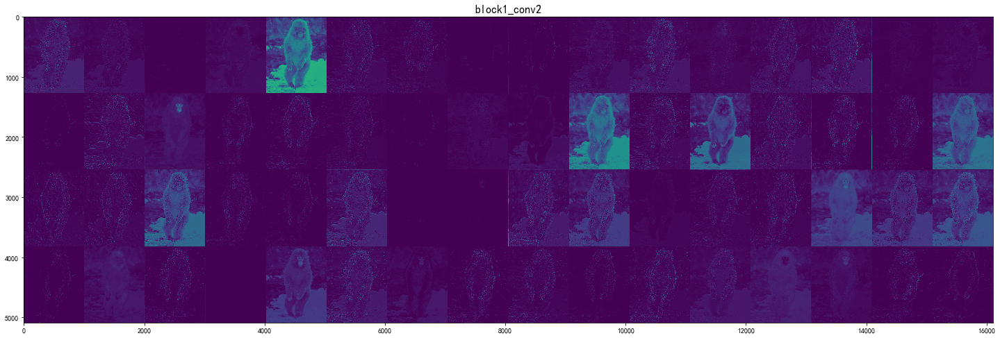

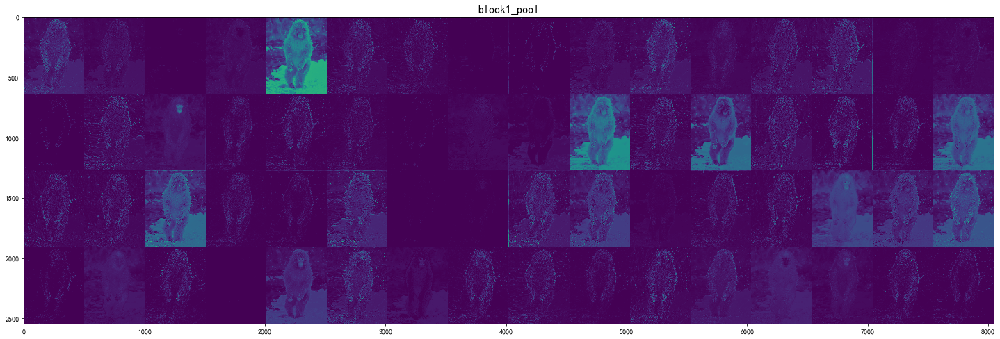

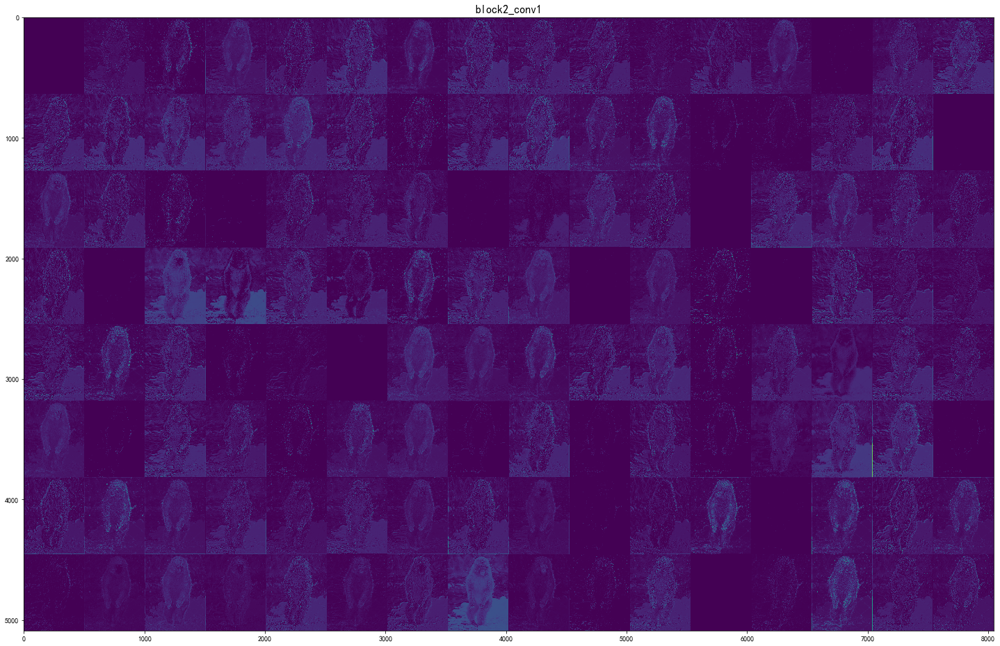

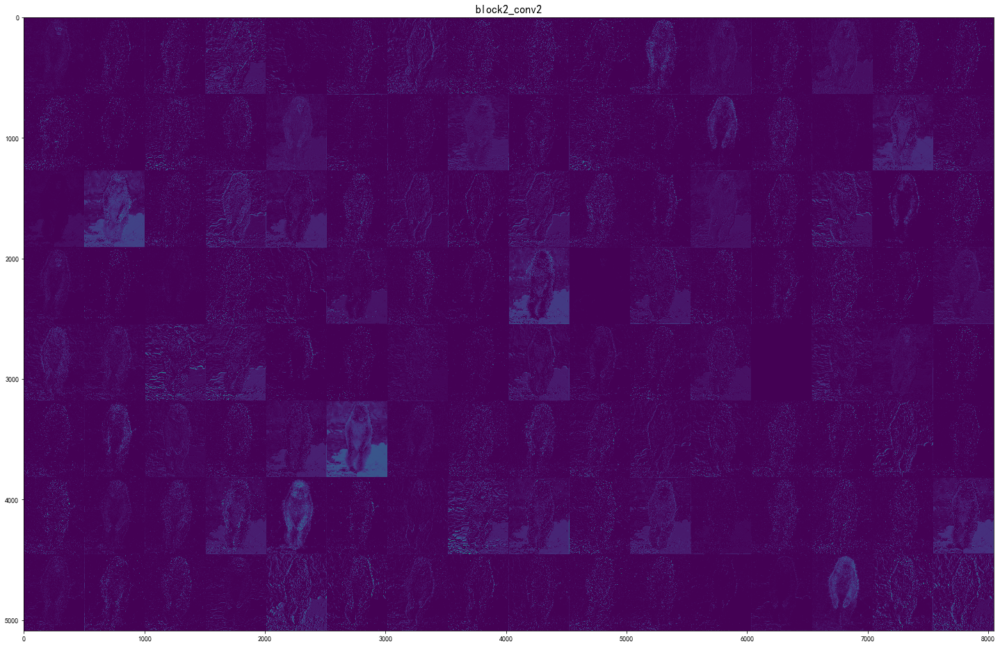

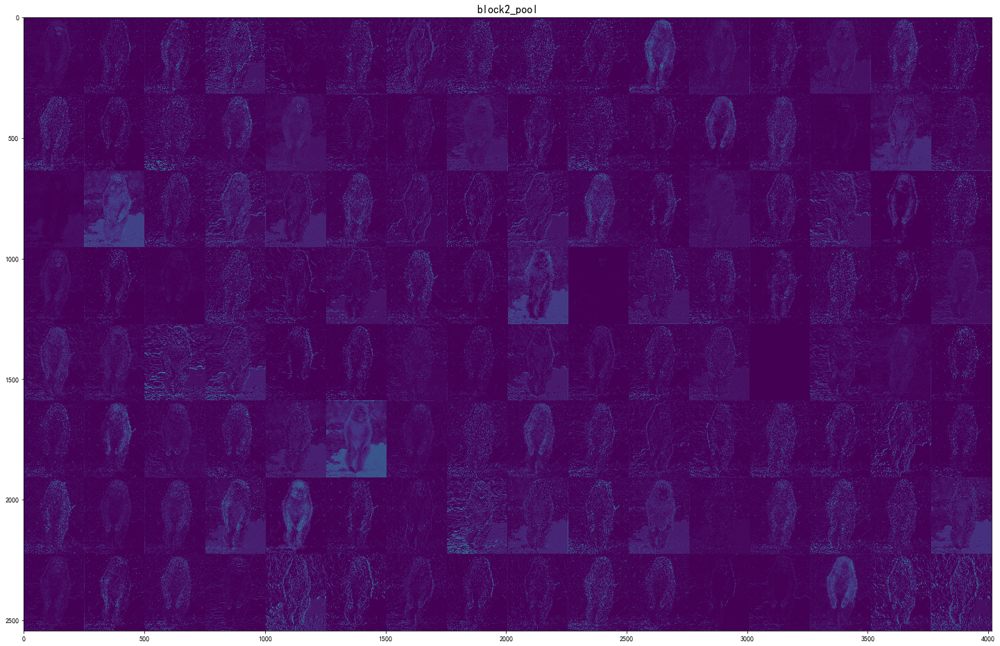

...

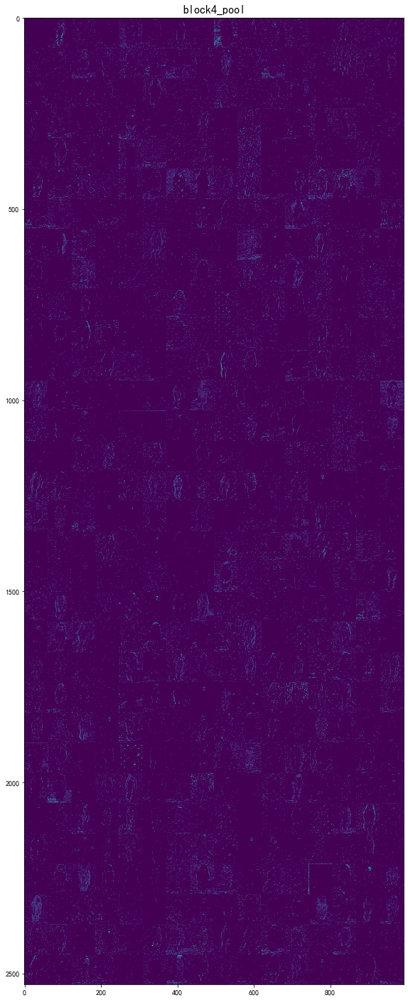

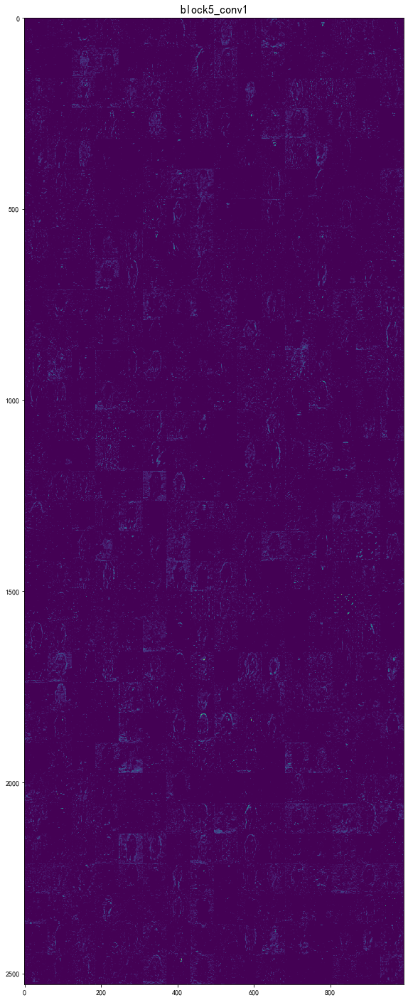

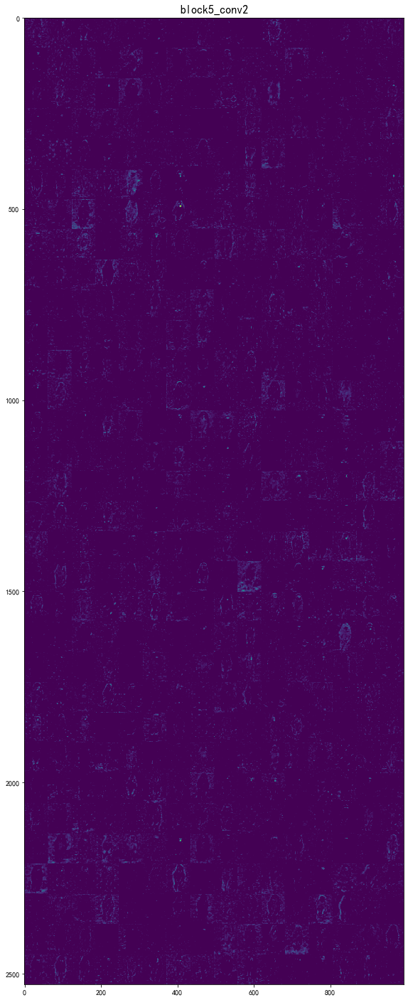

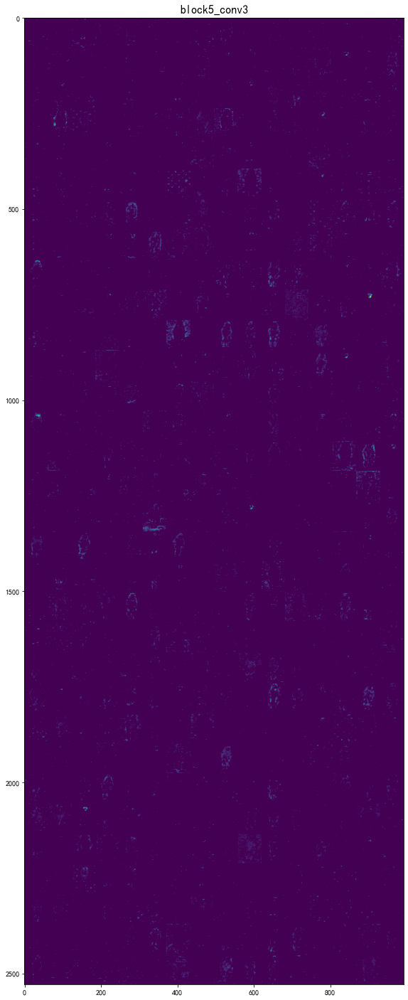

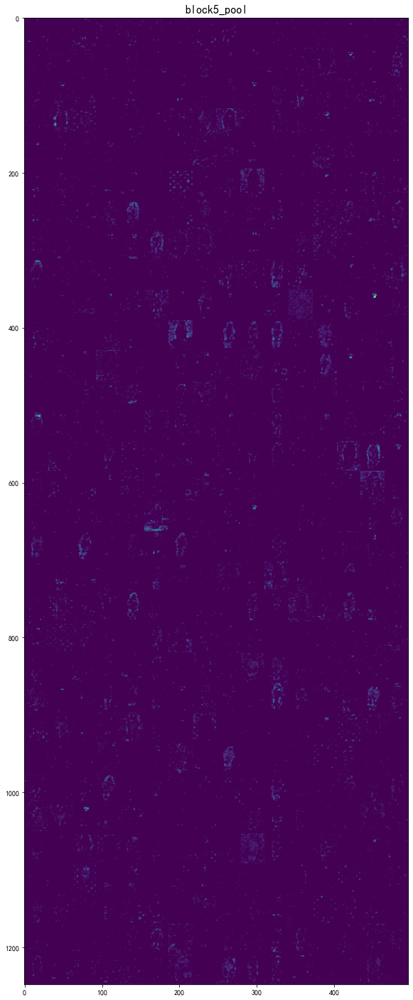

In [71]:
for activation,layer_name in zip(activations,layer_names):
    h = activation.shape[1]
    w = activation.shape[2]
    num_channels = activation.shape[3]
    cols = 16
    rows = math.ceil(num_channels/cols)
    img_grid = np.zeros((h*rows,w*cols))

    for c in range(num_channels):
        f_r = math.ceil((c+1)/cols)
        f_c = (c+1)if f_r==1 else (c+1-(f_r-1)*cols)
        img_grid[(f_r-1)*h:f_r*h,(f_c-1)*w:f_c*w ] = activation[0,:,:,c]


    plt.figure(figsize=(25,25))
    plt.imshow(img_grid, aspect='equal',cmap='viridis')
    plt.grid(False)
    plt.title(layer_name,fontsize=16)
plt.show()